In [1]:
!pip install torcheval

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 5.6 MB/s eta 0:00:00


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from torcheval.metrics.functional import peak_signal_noise_ratio
from PIL import Image
import os
import numpy as np
import matplotlib.pyplot as plt

In [3]:
seed = 42
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)

In [4]:
!gdown '1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3'

Downloading...
From (original): https://drive.google.com/uc?id=1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3
From (redirected): https://drive.google.com/uc?id=1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3&confirm=t&uuid=7d4e50b1-c8e0-464f-ade8-64128f2148d2
To: /kaggle/working/Khoa_LHR_image.zip
100%|██████████████████████████████████████| 89.0M/89.0M [00:01<00:00, 44.7MB/s]


In [5]:
!unzip '/kaggle/working/Khoa_LHR_image.zip' -d '/kaggle/working/'

Archive:  /kaggle/working/Khoa_LHR_image.zip
   creating: /kaggle/working/Khoa_LHR_image/
   creating: /kaggle/working/Khoa_LHR_image/train/
  inflating: /kaggle/working/Khoa_LHR_image/train/0.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/1.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/10.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/100.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/101.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/102.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/103.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/104.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/105.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/106.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/107.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/108.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/109.png  
  inflating: /kaggle/working/Khoa_LHR_image/train/11.png  
  inflating: /kaggle/work

In [6]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [7]:
class First_Feature(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(First_Feature, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.LeakyReLU()
        )

    def forward(self, x):
        return self.conv(x)

class Conv_Block(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Conv_Block, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class Encoder(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Encoder, self).__init__()
        self.encode = nn.Sequential(
            nn.MaxPool2d(2),
            Conv_Block(in_channels, out_channels)
        )

    def forward(self, x):
        return self.encode(x)

class Decoder(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Decoder, self).__init__()
        self.decode = nn.Sequential(
            nn.UpsamplingBilinear2d(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True)
        )
        self.conv = Conv_Block(in_channels, out_channels)

    def forward(self, x, skip):
        x = self.decode(x)
        x = torch.concat([x, skip], dim=1)
        x = self.conv(x)

        return x

class Final_Output(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Final_Output, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        return nn.functional.interpolate(self.conv(x),size=(256, 256), mode='bilinear', align_corners=False)

class Unet(nn.Module):
    def __init__(self, n_channels=3, n_classes=3):
        super(Unet, self).__init__()
        self.resize_func = transforms.Resize((low_height * 4, low_width * 4), antialias=True)

        self.conv_1 = First_Feature(n_channels, 64)
        self.conv_2 = Conv_Block(64, 64)

        self.encode_1 = Encoder(64, 128)
        self.encode_2 = Encoder(128, 256)
        self.encode_3 = Encoder(256, 512)
        self.encode_4 = Encoder(512, 1024)

        self.decode_1 = Decoder(1024, 512)
        self.decode_2 = Decoder(512, 256)
        self.decode_3 = Decoder(256, 128)
        self.decode_4 = Decoder(128, 64)

        self.out_conv = Final_Output(64, 3)

    def forward(self, x):
        x = self.resize_func(x)

        x = self.conv_1(x)
        x1 = self.conv_2(x)

        x2 = self.encode_1(x1)
        x3 = self.encode_2(x2)
        x4 = self.encode_3(x3)
        x5 = self.encode_4(x4)

        x = self.decode_1(x5, x4)
        x = self.decode_2(x, x3)
        x = self.decode_3(x, x2)
        x = self.decode_4(x, x1)

        x = self.out_conv(x)

        return x

In [8]:
train_path = 'Khoa_LHR_image/train/'
val_path = 'Khoa_LHR_image/val/'
batch_size = 8
learning_rate = 1e-4
epochs = 50
low_height = 64
low_width =  64

In [9]:
resize_func = transforms.Resize((low_height, low_width), antialias=True)

In [10]:
class ImageSet(Dataset):
  def __init__(self, img_dir, is_train=True):
    super(ImageSet, self).__init__()
    self.resize = transforms.Resize((low_height, low_width), antialias=True)
    self.img_dir = img_dir
    self.is_train = is_train
    self.images = os.listdir(img_dir)

  def __len__(self):
    return len(self.images)

  def normalize(self, input_image, target_image):
    input_image = (input_image * 2 - 1)
    target_image = (target_image * 2 - 1)

    return input_image, target_image

  def random_jitter(self, input_image, target_image):
    if torch.rand([]) < 0.5:
      input_image = transforms.functional.hflip(input_image)
      target_image = transforms.functional.hflip(target_image)

    return input_image, target_image

  def __getitem__(self, idx):
    img_path = os.path.join(self.img_dir, self.images[idx])
    image = np.array(Image.open(img_path).convert('RGB'))
    image = transforms.functional.to_tensor(image)
    input_image = self.resize(image).type(torch.float32)
    target_image = image.type(torch.float32)

    input_image, target_image = self.normalize(input_image, target_image)
    if self.is_train:
      input_image, target_image = self.random_jitter(input_image, target_image)

    return input_image, target_image

In [11]:
train_dataset = ImageSet(train_path, is_train=True)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataset = ImageSet(val_path, is_train=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

Text(0.5, 1.0, 'Target')

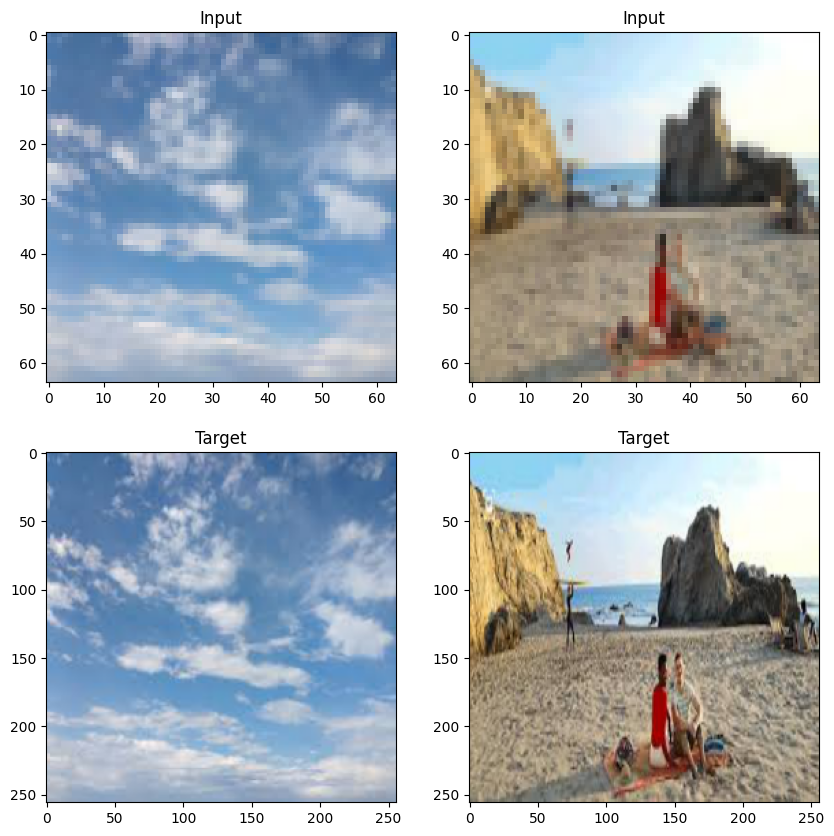

In [12]:
in_batch, tar_batch = next(iter(train_loader))
in_batch = (in_batch + 1)/2
tar_batch = (tar_batch + 1)/2

plt.figure(figsize=(10, 10))
ax = plt.subplot(2, 2, 1)
plt.imshow(np.squeeze(in_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Input")
ax = plt.subplot(2, 2, 3)
plt.imshow(np.squeeze(tar_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Target")
ax = plt.subplot(2, 2, 2)
plt.imshow(np.squeeze(in_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Input")
ax = plt.subplot(2, 2, 4)
plt.imshow(np.squeeze(tar_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Target")

In [13]:
def generate_images(model, inputs, labels):
    model.eval()
    with torch.no_grad():
        inputs, labels = inputs.to(device), labels.to(device)
        predictions = model(inputs)
    inputs, labels, predictions = inputs.cpu().numpy(), labels.cpu().numpy(), predictions.cpu().numpy()
    plt.figure(figsize=(15,20))

    display_list = [inputs[-1].transpose((1, 2, 0)), labels[-1].transpose((1, 2, 0)), predictions[-1].transpose((1, 2, 0))]
    title = ['Input', 'Real', 'Predicted']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] + 1) / 2)
        plt.axis('off')
    plt.show()

In [14]:
import time

def train_epoch(model, optimizer, criterion, train_loader, device, epoch=0, log_interval=50):
  model.train()
  train_losses = []
  train_psnr, train_count = 0, 0
  start_time = time.time()
  for idx,  (inputs, labels) in enumerate(train_loader):
    inputs, labels = inputs.to(device), labels.to(device)

    predictions = model(inputs)
    loss = criterion(predictions, labels)
    train_losses.append(loss.item())

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    train_psnr += peak_signal_noise_ratio(predictions, labels)
    train_count += 1

    if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            print(
                "| epoch {:3d} | {:5d}/{:5d} batches "
                "| psnr {:8.3f}".format(
                    epoch, idx, len(train_loader), train_psnr / train_count
                )
            )
            train_psnr, train_count = 0, 0
            start_time = time.time()

  loss = sum(train_losses) / len(train_losses)
  psnr = train_psnr/ train_count

  return loss, psnr

In [15]:
def evaluate(model, criterion, test_loader, device):
  model.eval()
  test_losses = []
  test_psnr, test_count = 0, 0
  start_time = time.time()
  with torch.no_grad():
    for idx, (inputs, labels) in enumerate(test_loader):
      inputs, labels = inputs.to(device), labels.to(device)

      predictions = model(inputs)
      loss = criterion(predictions, labels)
      test_losses.append(loss.item())

      test_psnr += peak_signal_noise_ratio(predictions, labels)
      test_count += 1

    loss = sum(test_losses) / len(test_losses)
    psnr = test_psnr / test_count

    return loss, psnr

In [16]:
def train(model, model_name, save_model, optimizer, criterion, train_loader, test_loader, device, num_epochs):
  train_losses, train_psnrs = [], []
  test_losses, test_psnrs = [], []
  best_eval = -1000
  times = []
  for epoch in range(1, num_epochs + 1):
    epoch_start_time = time.time()

    train_loss, train_psnr = train_epoch(model, optimizer, criterion, train_loader, device, epoch)
    train_losses.append(train_loss)
    train_psnrs.append(train_psnr.cpu())

    test_loss, test_psnr = evaluate(model, criterion, test_loader, device)
    test_losses.append(test_loss)
    test_psnrs.append(test_psnr.cpu())

    if best_eval < test_psnr:
      best_eval = test_psnr
      torch.save(model.state_dict(), save_model + f'/{model_name}.pt')
      inputs_t, targets_t = next(iter(test_loader))
      generate_images(model, inputs_t, targets_t)
      best_psnr_eval = test_psnr
    times.append(time.time() - epoch_start_time)

    print("-" * 59)
    print(
        "| End of epoch {:3d} | Time: {:5.2f}s | Train psnr {:8.3f} | Train Loss {:8.3f} "
        "| Valid psnr {:8.3f} | Valid Loss {:8.3f} ".format(
            epoch, time.time() - epoch_start_time, train_psnr, train_loss, test_psnr, test_loss
        )
    )
    print("-" * 59)

    model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))
    model.eval()
    metrics = {
        'train_psnr': train_psnrs,
        'train_loss': train_losses,
        'valid_psnr': test_psnrs,
        'valid_loss': test_losses,
        'time': times
    }

  return model, metrics

In [17]:
import matplotlib.pyplot as plt

def plot_result(num_epochs, train_psnrs, eval_psnrs, train_losses, eval_losses):
    epochs = list(range(num_epochs))
    fig, axs = plt.subplots(nrows = 1, ncols =2 , figsize = (12,6))
    axs[0].plot(epochs, train_psnrs, label = "Training")
    axs[0].plot(epochs, eval_psnrs, label = "Evaluation")
    axs[1].plot(epochs, train_losses, label = "Training")
    axs[1].plot(epochs, eval_losses, label = "Evaluation")
    axs[0].set_xlabel("Epochs")
    axs[1].set_xlabel("Epochs")
    axs[0].set_ylabel("PSNR")
    axs[1].set_ylabel("Loss")
    plt.legend()

In [18]:
import matplotlib.pyplot as plt

def predict_and_display(model, test_dataloader, device):
    model.eval()

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(test_dataloader):
            if idx >= 10:
                break
            inputs = inputs.to(device)
            predictions = model(inputs)
            generate_images(model, inputs, labels)
            plt.show()

| epoch   1 |    50/   86 batches | psnr   18.271


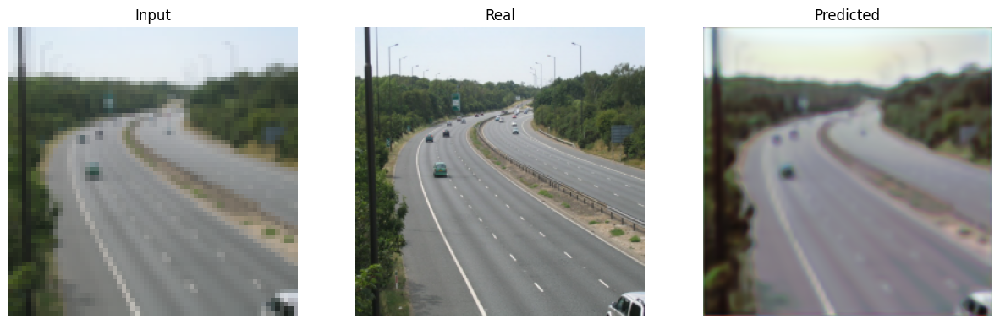

-----------------------------------------------------------
| End of epoch   1 | Time: 28.98s | Train psnr   20.386 | Train Loss    0.178 | Valid psnr   22.265 | Valid Loss    0.105 
-----------------------------------------------------------


<ipython-input-16-07fd8a1a5bbc>:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


| epoch   2 |    50/   86 batches | psnr   21.622


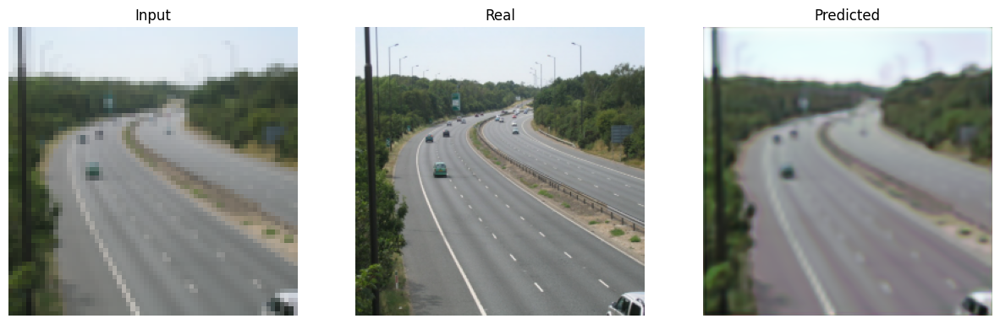

-----------------------------------------------------------
| End of epoch   2 | Time: 28.02s | Train psnr   21.690 | Train Loss    0.121 | Valid psnr   23.231 | Valid Loss    0.091 
-----------------------------------------------------------
| epoch   3 |    50/   86 batches | psnr   22.275


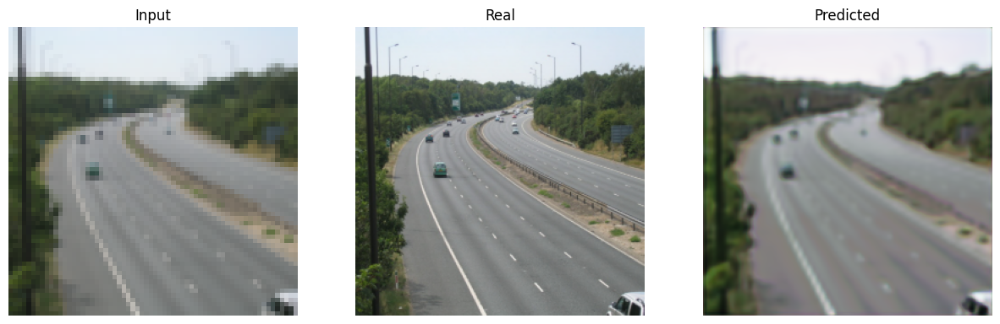

-----------------------------------------------------------
| End of epoch   3 | Time: 28.02s | Train psnr   22.270 | Train Loss    0.111 | Valid psnr   23.554 | Valid Loss    0.087 
-----------------------------------------------------------
| epoch   4 |    50/   86 batches | psnr   22.713


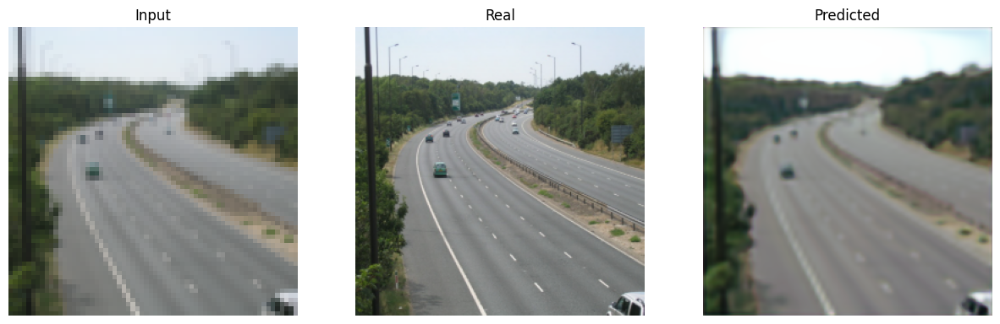

-----------------------------------------------------------
| End of epoch   4 | Time: 27.88s | Train psnr   22.887 | Train Loss    0.103 | Valid psnr   23.555 | Valid Loss    0.086 
-----------------------------------------------------------
| epoch   5 |    50/   86 batches | psnr   23.072


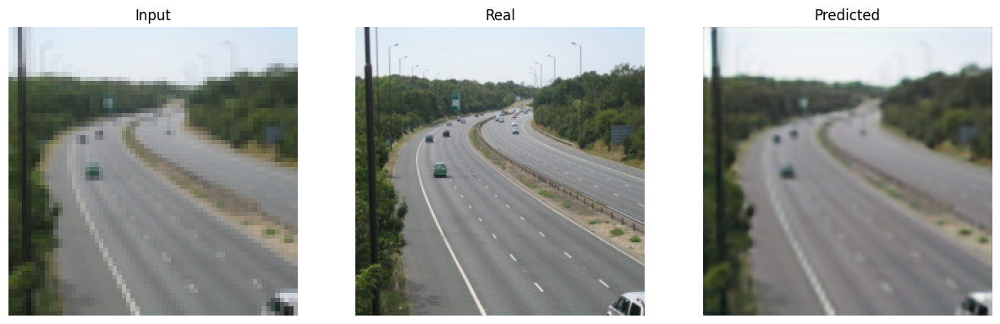

-----------------------------------------------------------
| End of epoch   5 | Time: 27.94s | Train psnr   23.037 | Train Loss    0.100 | Valid psnr   23.921 | Valid Loss    0.083 
-----------------------------------------------------------
| epoch   6 |    50/   86 batches | psnr   23.173


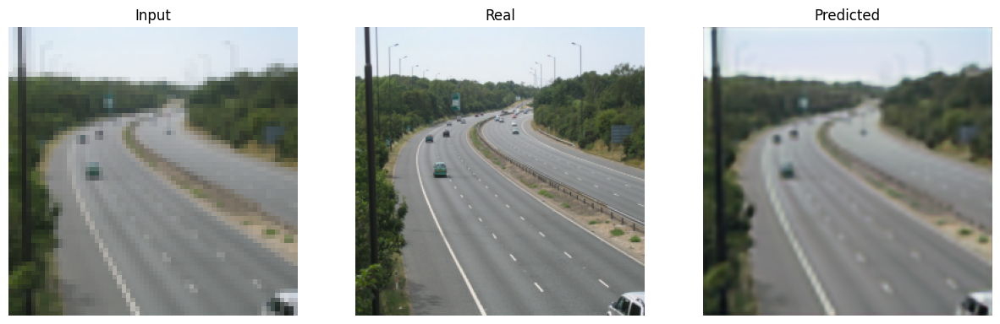

-----------------------------------------------------------
| End of epoch   6 | Time: 27.96s | Train psnr   23.475 | Train Loss    0.096 | Valid psnr   23.972 | Valid Loss    0.082 
-----------------------------------------------------------
| epoch   7 |    50/   86 batches | psnr   23.508
-----------------------------------------------------------
| End of epoch   7 | Time: 27.15s | Train psnr   23.463 | Train Loss    0.093 | Valid psnr   22.849 | Valid Loss    0.101 
-----------------------------------------------------------
| epoch   8 |    50/   86 batches | psnr   23.320
-----------------------------------------------------------
| End of epoch   8 | Time: 27.24s | Train psnr   23.640 | Train Loss    0.093 | Valid psnr   23.796 | Valid Loss    0.083 
-----------------------------------------------------------
| epoch   9 |    50/   86 batches | psnr   23.398


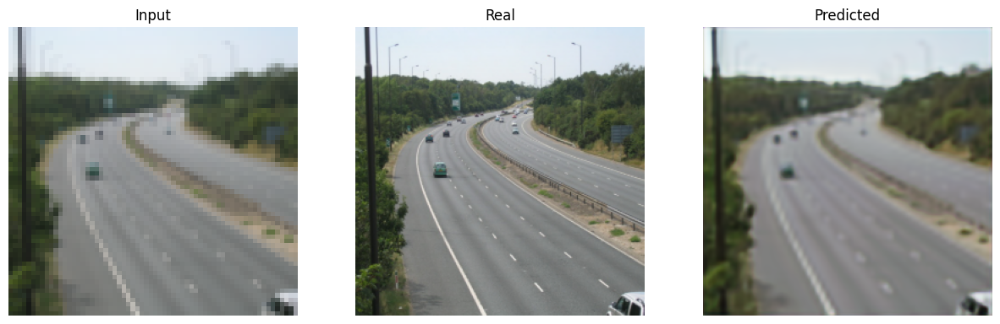

-----------------------------------------------------------
| End of epoch   9 | Time: 28.04s | Train psnr   23.211 | Train Loss    0.095 | Valid psnr   24.278 | Valid Loss    0.077 
-----------------------------------------------------------
| epoch  10 |    50/   86 batches | psnr   23.472


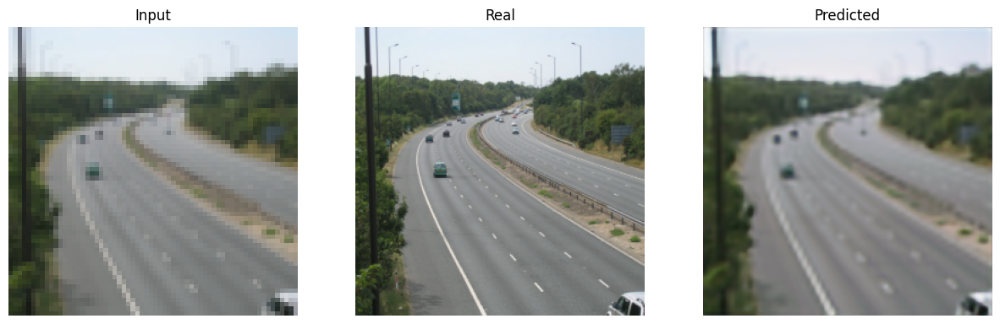

-----------------------------------------------------------
| End of epoch  10 | Time: 28.02s | Train psnr   23.629 | Train Loss    0.092 | Valid psnr   24.369 | Valid Loss    0.075 
-----------------------------------------------------------
| epoch  11 |    50/   86 batches | psnr   23.764


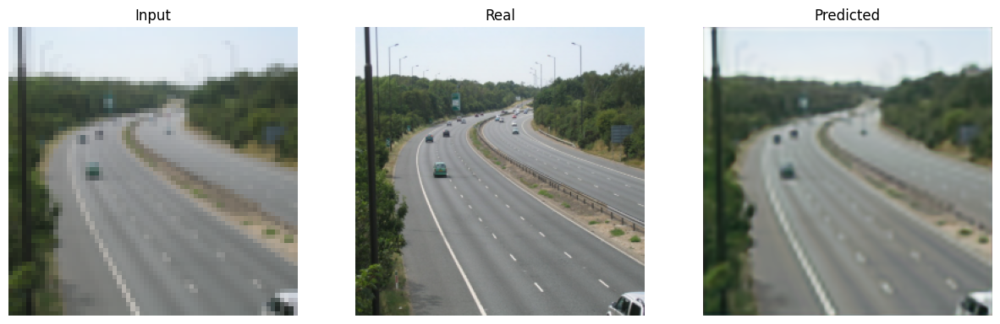

-----------------------------------------------------------
| End of epoch  11 | Time: 28.06s | Train psnr   23.710 | Train Loss    0.089 | Valid psnr   24.393 | Valid Loss    0.076 
-----------------------------------------------------------
| epoch  12 |    50/   86 batches | psnr   23.769
-----------------------------------------------------------
| End of epoch  12 | Time: 27.27s | Train psnr   23.773 | Train Loss    0.088 | Valid psnr   23.785 | Valid Loss    0.084 
-----------------------------------------------------------
| epoch  13 |    50/   86 batches | psnr   23.875
-----------------------------------------------------------
| End of epoch  13 | Time: 27.23s | Train psnr   23.975 | Train Loss    0.085 | Valid psnr   24.335 | Valid Loss    0.077 
-----------------------------------------------------------
| epoch  14 |    50/   86 batches | psnr   23.819
-----------------------------------------------------------
| End of epoch  14 | Time: 27.30s | Train psnr   23.782 | Tra

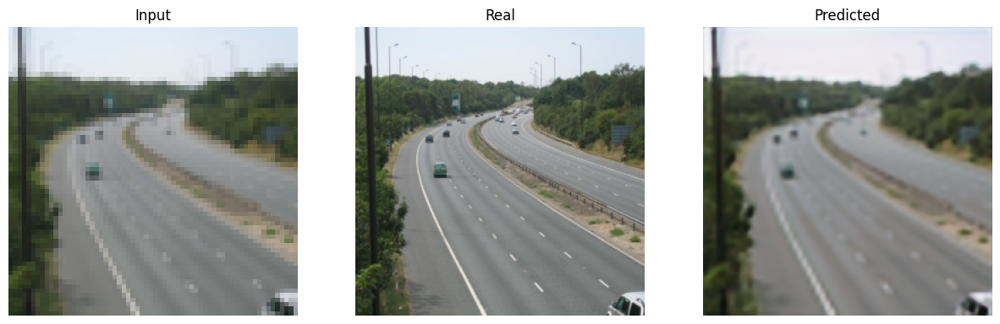

-----------------------------------------------------------
| End of epoch  18 | Time: 28.14s | Train psnr   23.949 | Train Loss    0.087 | Valid psnr   24.425 | Valid Loss    0.075 
-----------------------------------------------------------
| epoch  19 |    50/   86 batches | psnr   23.860


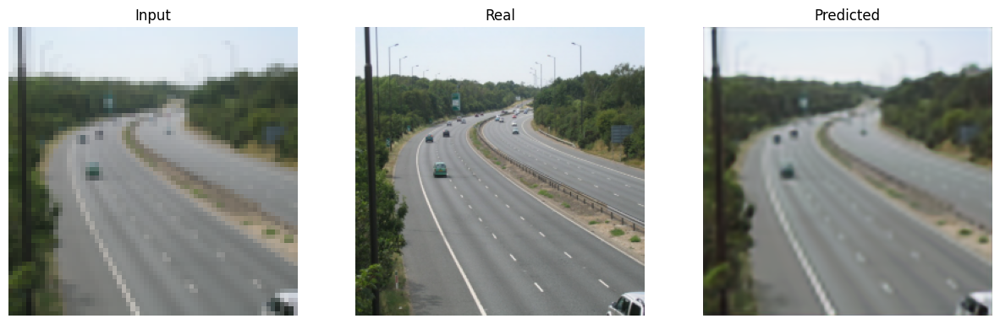

-----------------------------------------------------------
| End of epoch  19 | Time: 27.96s | Train psnr   24.112 | Train Loss    0.086 | Valid psnr   24.552 | Valid Loss    0.073 
-----------------------------------------------------------
| epoch  20 |    50/   86 batches | psnr   23.759
-----------------------------------------------------------
| End of epoch  20 | Time: 27.24s | Train psnr   23.896 | Train Loss    0.088 | Valid psnr   24.525 | Valid Loss    0.074 
-----------------------------------------------------------
| epoch  21 |    50/   86 batches | psnr   24.123
-----------------------------------------------------------
| End of epoch  21 | Time: 27.22s | Train psnr   24.146 | Train Loss    0.083 | Valid psnr   24.507 | Valid Loss    0.074 
-----------------------------------------------------------
| epoch  22 |    50/   86 batches | psnr   23.940
-----------------------------------------------------------
| End of epoch  22 | Time: 27.22s | Train psnr   23.941 | Tra

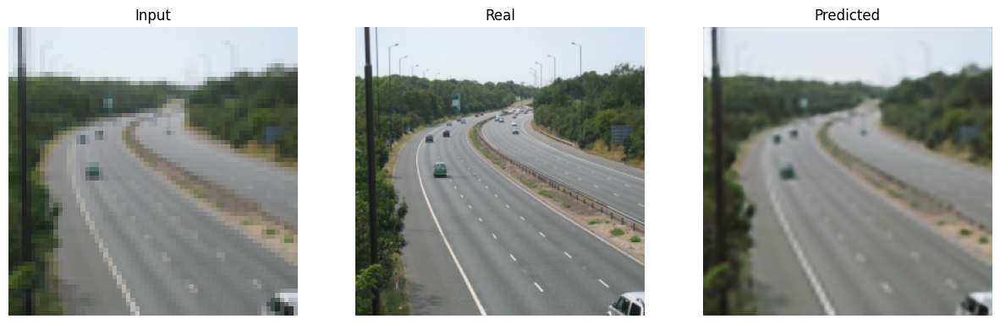

-----------------------------------------------------------
| End of epoch  27 | Time: 27.97s | Train psnr   23.890 | Train Loss    0.085 | Valid psnr   24.563 | Valid Loss    0.073 
-----------------------------------------------------------
| epoch  28 |    50/   86 batches | psnr   24.033
-----------------------------------------------------------
| End of epoch  28 | Time: 27.23s | Train psnr   23.872 | Train Loss    0.086 | Valid psnr   24.405 | Valid Loss    0.077 
-----------------------------------------------------------
| epoch  29 |    50/   86 batches | psnr   24.097
-----------------------------------------------------------
| End of epoch  29 | Time: 27.22s | Train psnr   24.036 | Train Loss    0.084 | Valid psnr   24.443 | Valid Loss    0.075 
-----------------------------------------------------------
| epoch  30 |    50/   86 batches | psnr   24.188
-----------------------------------------------------------
| End of epoch  30 | Time: 27.22s | Train psnr   24.012 | Tra

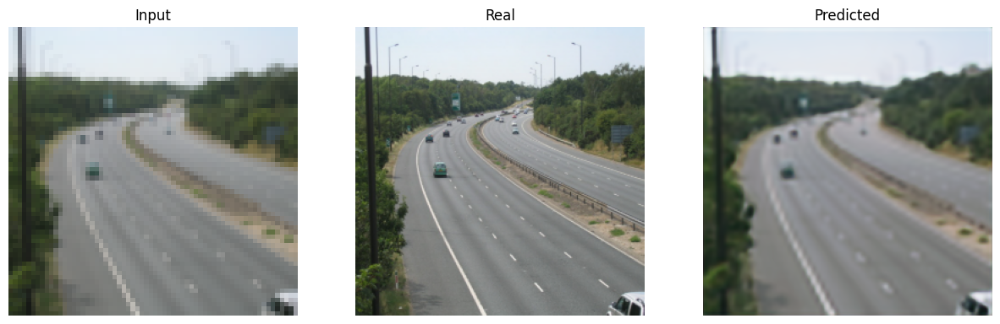

-----------------------------------------------------------
| End of epoch  53 | Time: 28.01s | Train psnr   24.080 | Train Loss    0.084 | Valid psnr   24.566 | Valid Loss    0.073 
-----------------------------------------------------------
| epoch  54 |    50/   86 batches | psnr   23.968


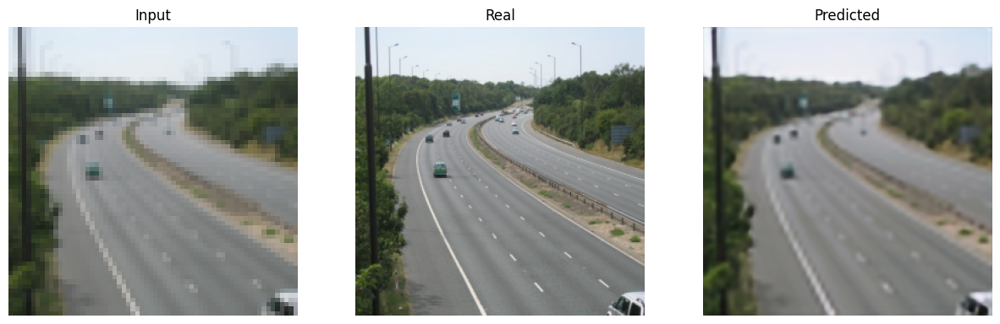

-----------------------------------------------------------
| End of epoch  54 | Time: 28.05s | Train psnr   24.294 | Train Loss    0.083 | Valid psnr   24.697 | Valid Loss    0.071 
-----------------------------------------------------------
| epoch  55 |    50/   86 batches | psnr   24.027
-----------------------------------------------------------
| End of epoch  55 | Time: 27.24s | Train psnr   24.219 | Train Loss    0.083 | Valid psnr   24.467 | Valid Loss    0.075 
-----------------------------------------------------------
| epoch  56 |    50/   86 batches | psnr   24.222
-----------------------------------------------------------
| End of epoch  56 | Time: 27.28s | Train psnr   24.093 | Train Loss    0.083 | Valid psnr   24.502 | Valid Loss    0.076 
-----------------------------------------------------------
| epoch  57 |    50/   86 batches | psnr   23.892
-----------------------------------------------------------
| End of epoch  57 | Time: 27.25s | Train psnr   23.917 | Tra

In [19]:
model = Unet()
model = model.to(device)

criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate, betas=[0.5,0.999])
epochs = 65

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

model, metrics = train(model, 'UNET', save_model, optimizer, criterion, train_loader, test_loader, device, epochs)

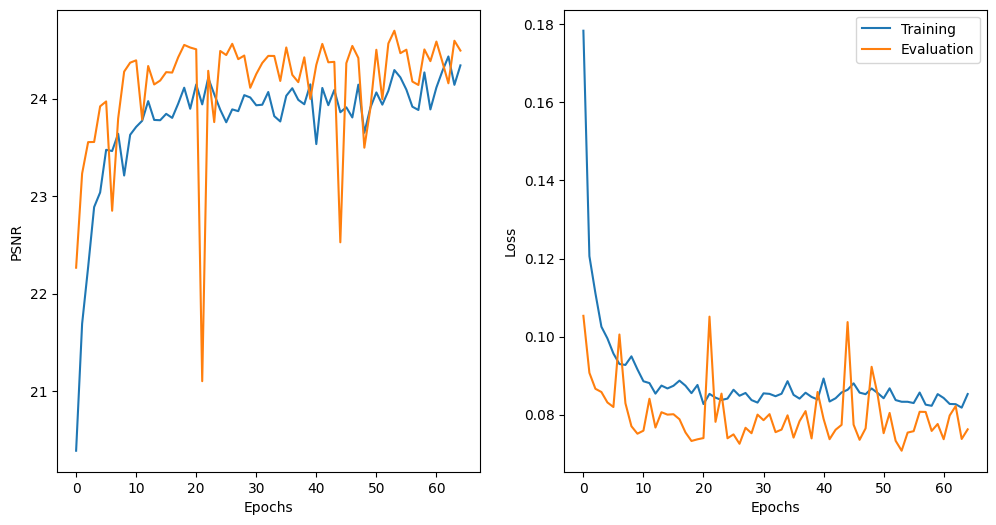

In [20]:
plot_result(
    epochs,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [21]:
test_psnr, test_loss = evaluate(model, criterion, test_loader, device)
test_psnr, test_loss

(0.0707612672651356, tensor(24.6973, device='cuda:0'))

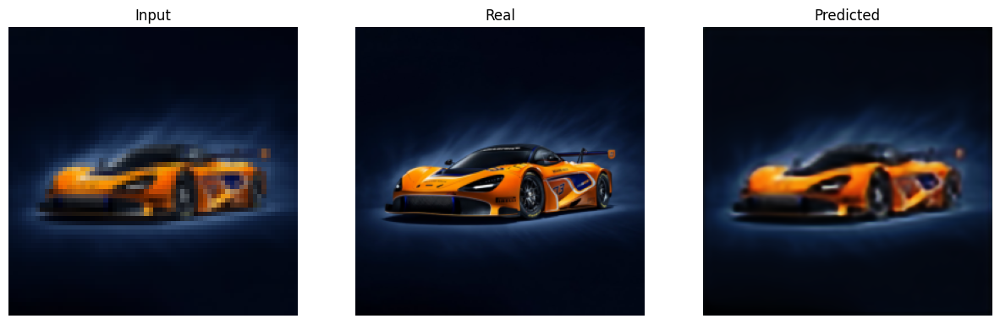

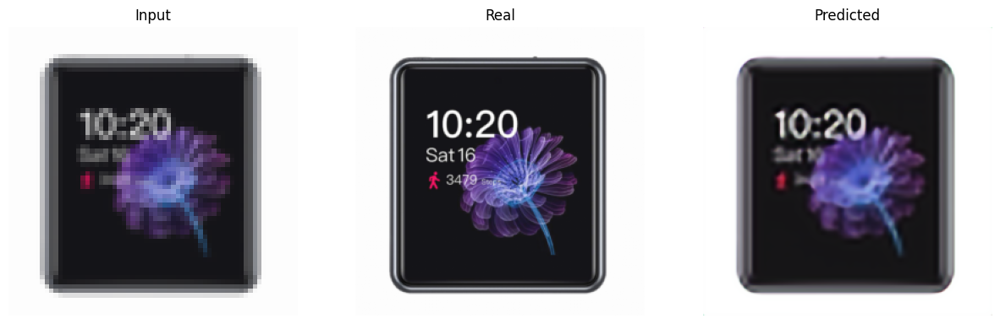

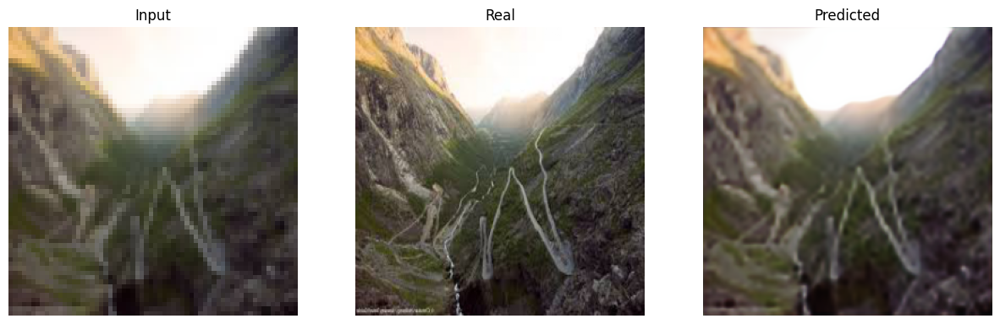

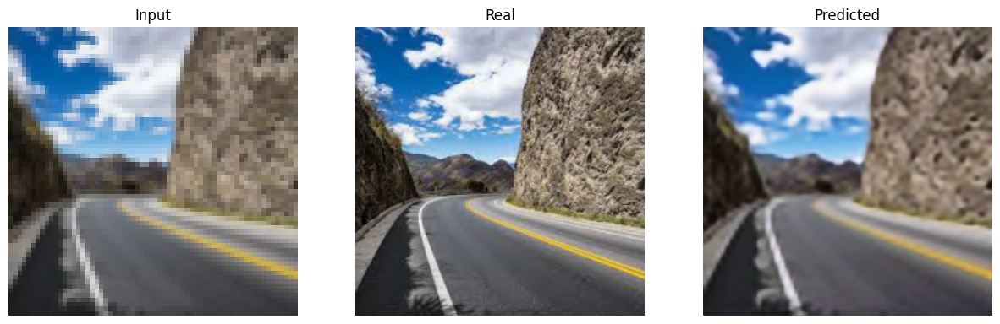

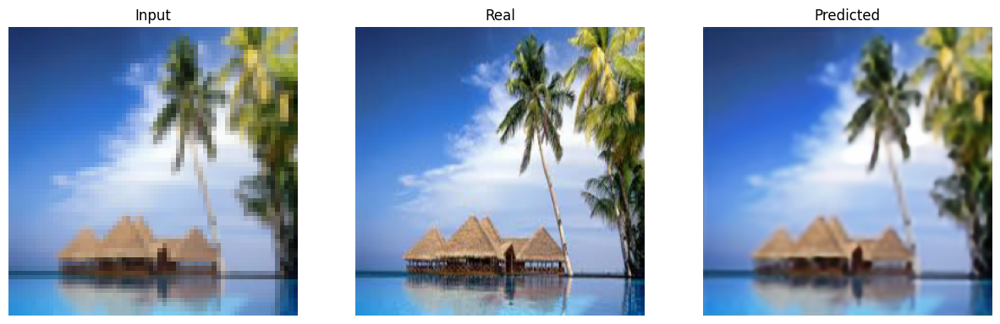

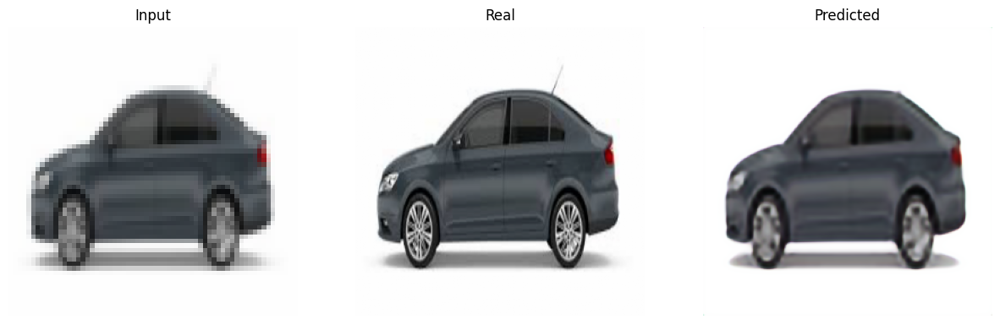

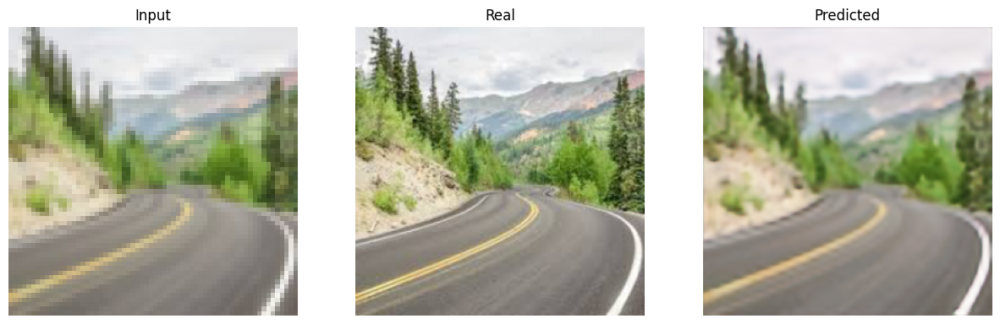

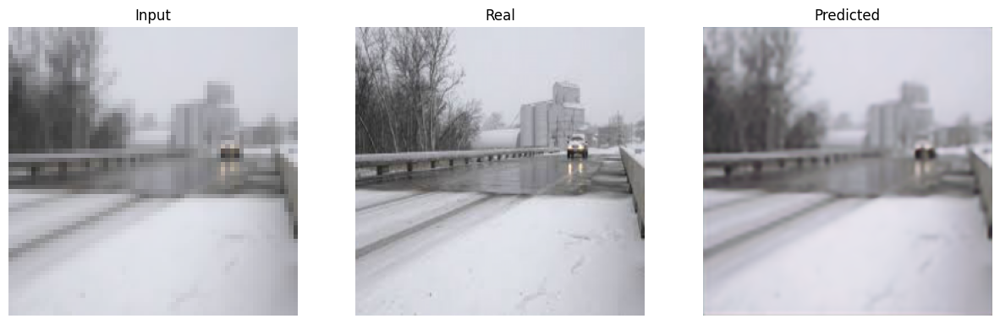

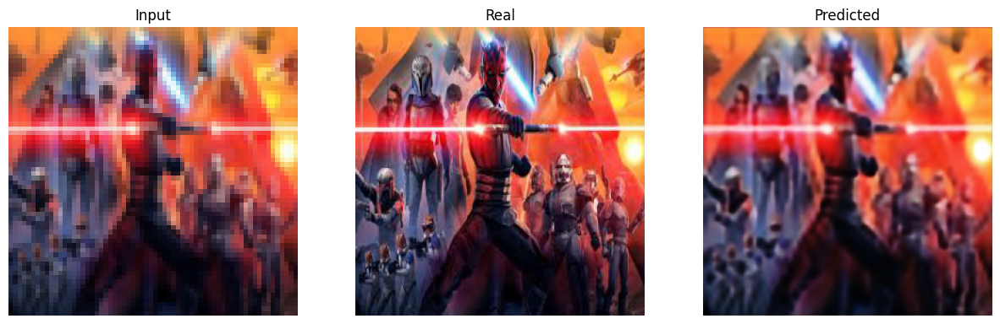

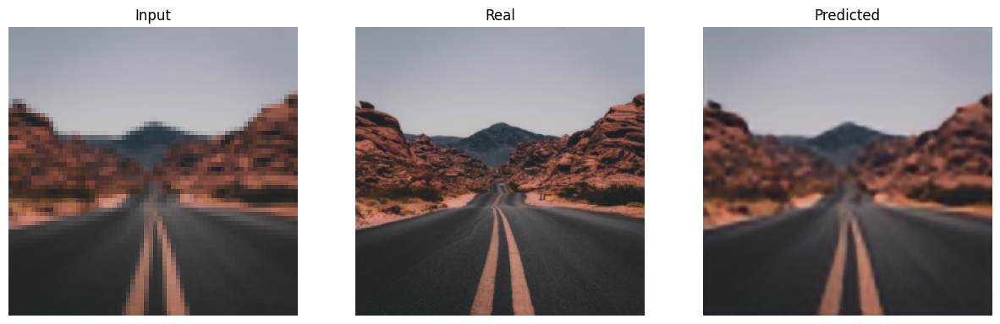

In [22]:
predict_and_display(model, train_loader, device)

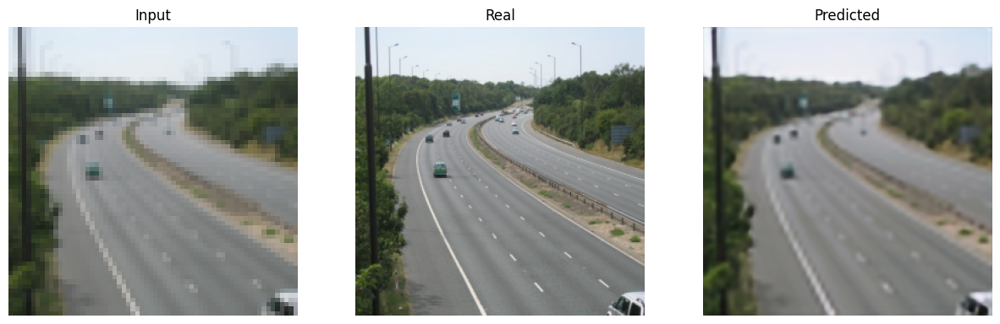

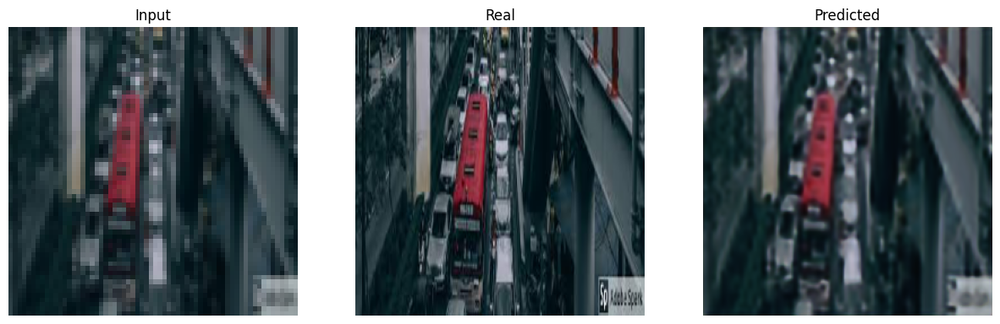

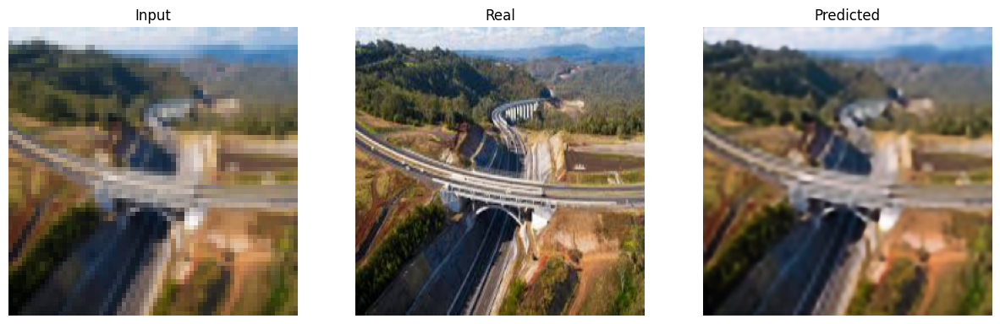

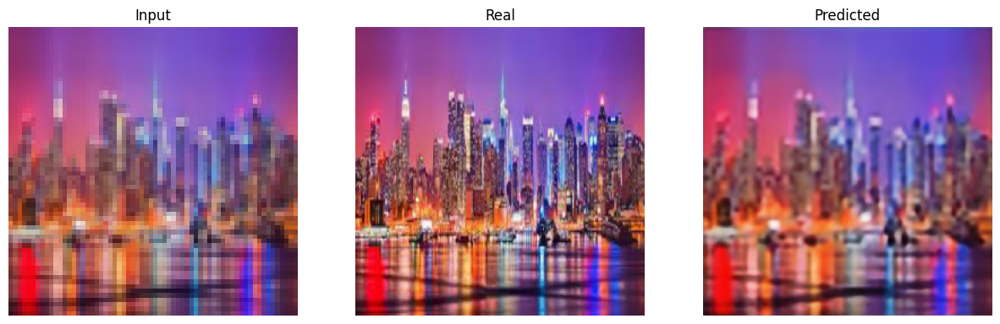

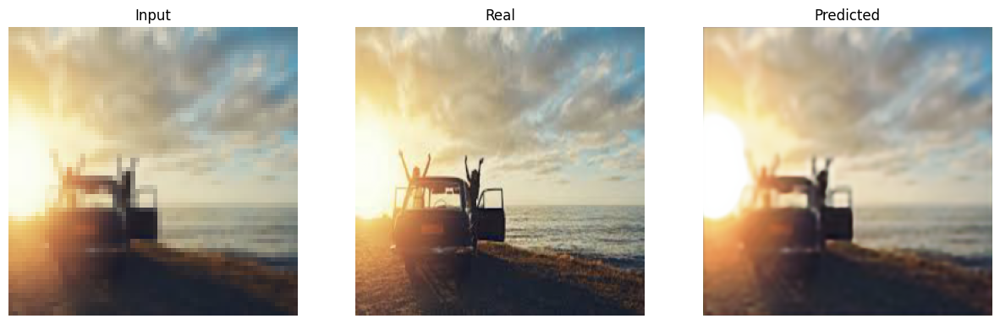

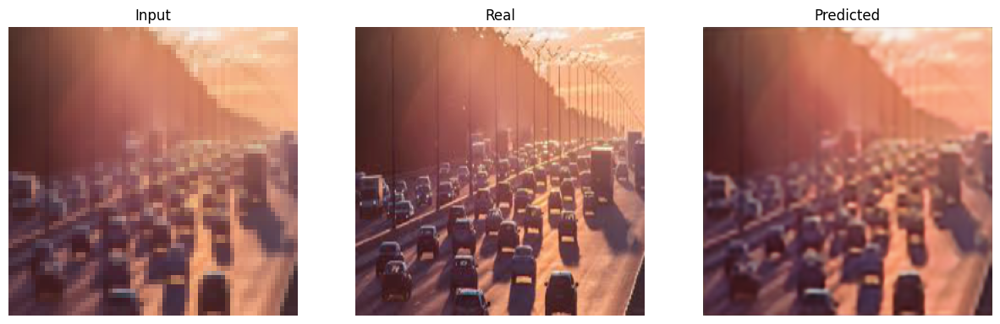

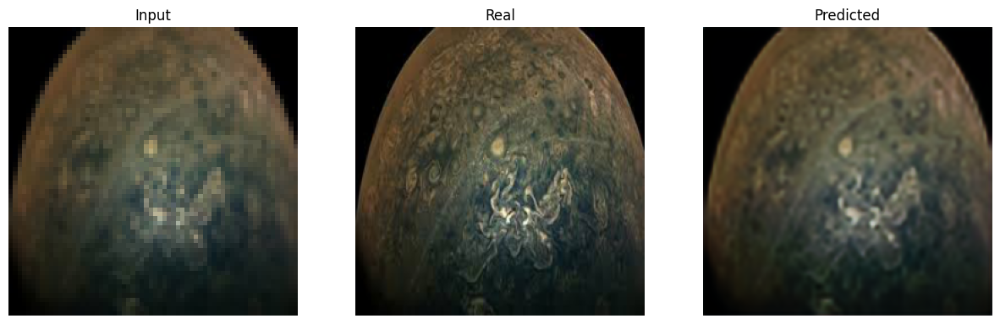

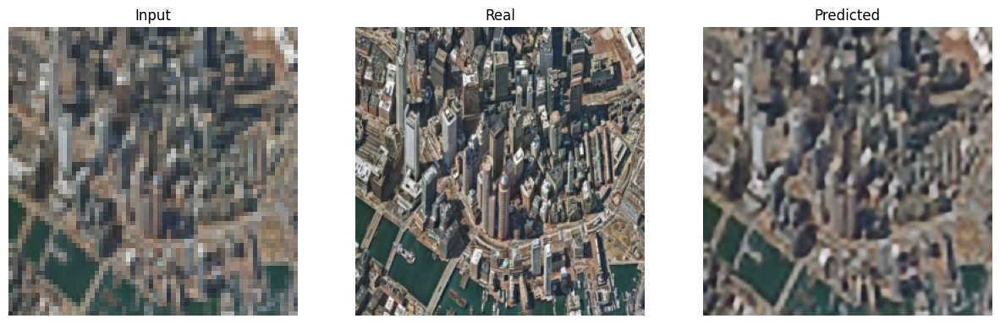

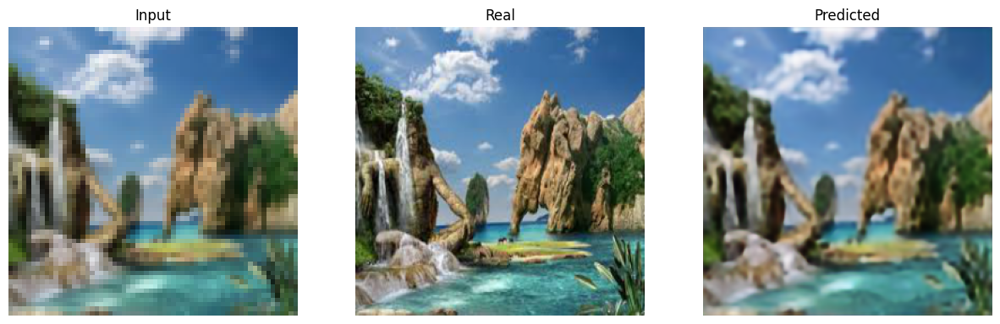

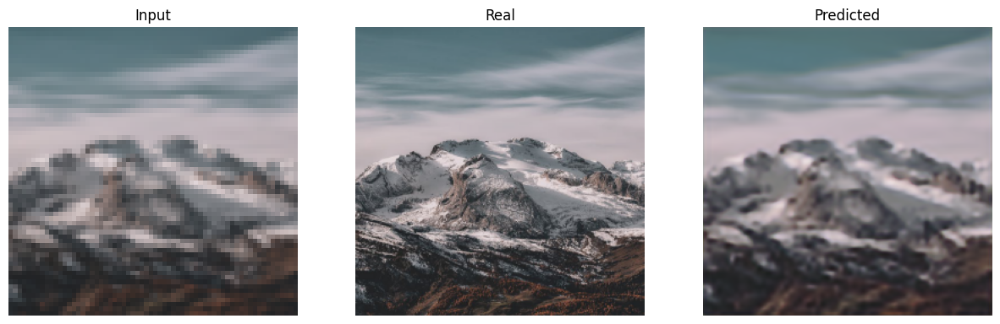

In [23]:
predict_and_display(model, test_loader, device)

## UNET No Skip-connection

In [24]:
class DecoderNoSkip(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DecoderNoSkip, self).__init__()
        self.decode = nn.Sequential(
            nn.UpsamplingBilinear2d(scale_factor=2),
            nn.Conv2d(in_channels, out_channels * 2, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels * 2),
            nn.LeakyReLU(inplace=True)
        )
        self.conv = Conv_Block(in_channels, out_channels)

    def forward(self, x):
        x = self.decode(x)
        # x = torch.concat([x, skip], dim=1)
        x = self.conv(x)

        return x

class UnetNoSkip(nn.Module):
    def __init__(self, n_channels=3, n_classes=3):
        super(UnetNoSkip, self).__init__()
        self.resize_func = transforms.Resize((low_height * 4, low_width * 4), antialias=True)

        self.conv_1 = First_Feature(n_channels, 64)
        self.conv_2 = Conv_Block(64, 64)

        self.encode_1 = Encoder(64, 128)
        self.encode_2 = Encoder(128, 256)
        self.encode_3 = Encoder(256, 512)
        self.encode_4 = Encoder(512, 1024)

        self.decode_1 = DecoderNoSkip(1024, 512)
        self.decode_2 = DecoderNoSkip(512, 256)
        self.decode_3 = DecoderNoSkip(256, 128)
        self.decode_4 = DecoderNoSkip(128, 64)

        self.out_conv = Final_Output(64, 3)

    def forward(self, x):
        x = self.resize_func(x)

        x = self.conv_1(x)
        x1 = self.conv_2(x)

        x2 = self.encode_1(x1)
        x3 = self.encode_2(x2)
        x4 = self.encode_3(x3)
        x5 = self.encode_4(x4)

        x = self.decode_1(x5)
        x = self.decode_2(x)
        x = self.decode_3(x)
        x = self.decode_4(x)

        x = self.out_conv(x)

        return x

| epoch   1 |    50/   86 batches | psnr   14.712


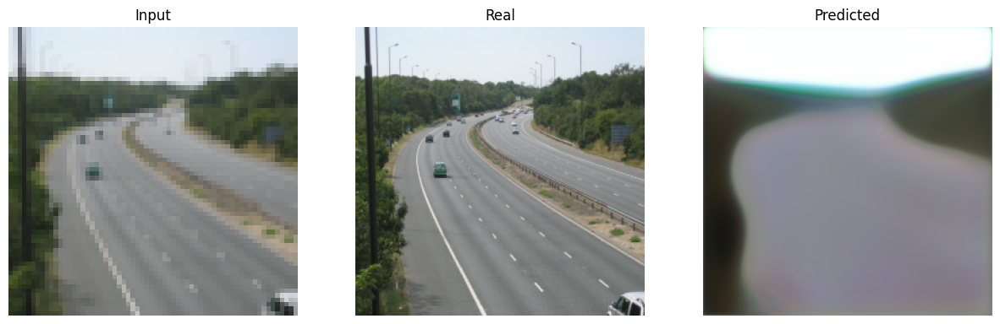

-----------------------------------------------------------
| End of epoch   1 | Time: 29.15s | Train psnr   15.710 | Train Loss    0.262 | Valid psnr   15.385 | Valid Loss    0.234 
-----------------------------------------------------------


<ipython-input-16-07fd8a1a5bbc>:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


| epoch   2 |    50/   86 batches | psnr   16.219


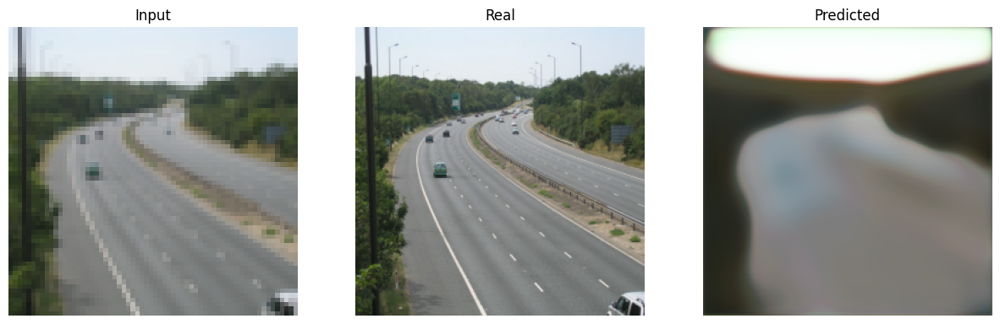

-----------------------------------------------------------
| End of epoch   2 | Time: 29.34s | Train psnr   16.564 | Train Loss    0.214 | Valid psnr   15.852 | Valid Loss    0.224 
-----------------------------------------------------------
| epoch   3 |    50/   86 batches | psnr   16.908


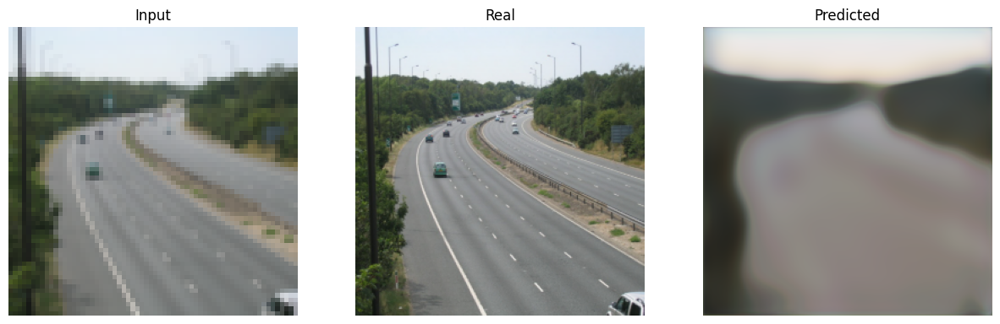

-----------------------------------------------------------
| End of epoch   3 | Time: 29.35s | Train psnr   16.897 | Train Loss    0.199 | Valid psnr   17.408 | Valid Loss    0.189 
-----------------------------------------------------------
| epoch   4 |    50/   86 batches | psnr   17.318
-----------------------------------------------------------
| End of epoch   4 | Time: 28.60s | Train psnr   16.990 | Train Loss    0.191 | Valid psnr   14.515 | Valid Loss    0.270 
-----------------------------------------------------------
| epoch   5 |    50/   86 batches | psnr   17.184


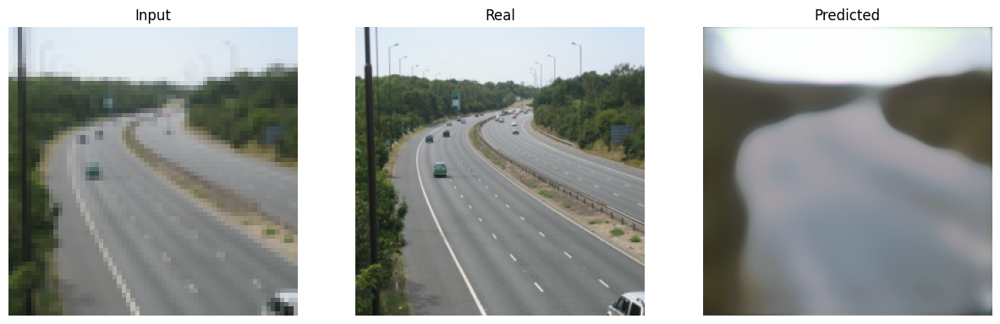

-----------------------------------------------------------
| End of epoch   5 | Time: 29.42s | Train psnr   17.313 | Train Loss    0.190 | Valid psnr   17.574 | Valid Loss    0.178 
-----------------------------------------------------------
| epoch   6 |    50/   86 batches | psnr   16.590
-----------------------------------------------------------
| End of epoch   6 | Time: 28.63s | Train psnr   17.443 | Train Loss    0.199 | Valid psnr   17.351 | Valid Loss    0.190 
-----------------------------------------------------------
| epoch   7 |    50/   86 batches | psnr   16.649
-----------------------------------------------------------
| End of epoch   7 | Time: 28.62s | Train psnr   17.427 | Train Loss    0.197 | Valid psnr   17.514 | Valid Loss    0.181 
-----------------------------------------------------------
| epoch   8 |    50/   86 batches | psnr   17.362
-----------------------------------------------------------
| End of epoch   8 | Time: 28.60s | Train psnr   17.131 | Tra

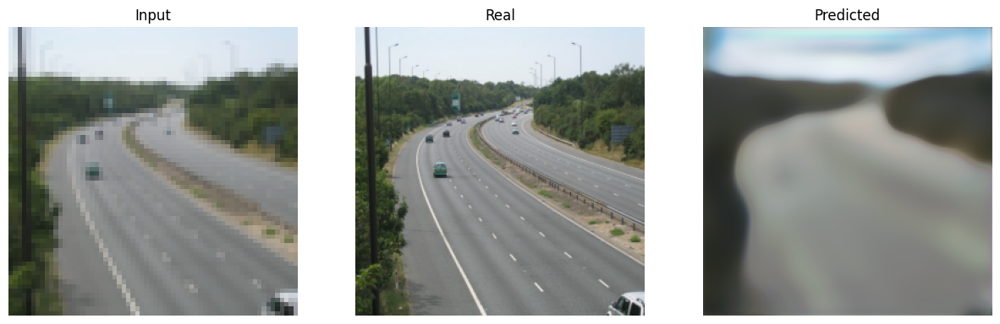

-----------------------------------------------------------
| End of epoch   9 | Time: 29.47s | Train psnr   17.129 | Train Loss    0.208 | Valid psnr   17.807 | Valid Loss    0.174 
-----------------------------------------------------------
| epoch  10 |    50/   86 batches | psnr   17.378
-----------------------------------------------------------
| End of epoch  10 | Time: 28.64s | Train psnr   17.698 | Train Loss    0.182 | Valid psnr   17.716 | Valid Loss    0.180 
-----------------------------------------------------------
| epoch  11 |    50/   86 batches | psnr   17.558
-----------------------------------------------------------
| End of epoch  11 | Time: 28.62s | Train psnr   17.707 | Train Loss    0.179 | Valid psnr   17.653 | Valid Loss    0.178 
-----------------------------------------------------------
| epoch  12 |    50/   86 batches | psnr   17.276
-----------------------------------------------------------
| End of epoch  12 | Time: 28.59s | Train psnr   17.667 | Tra

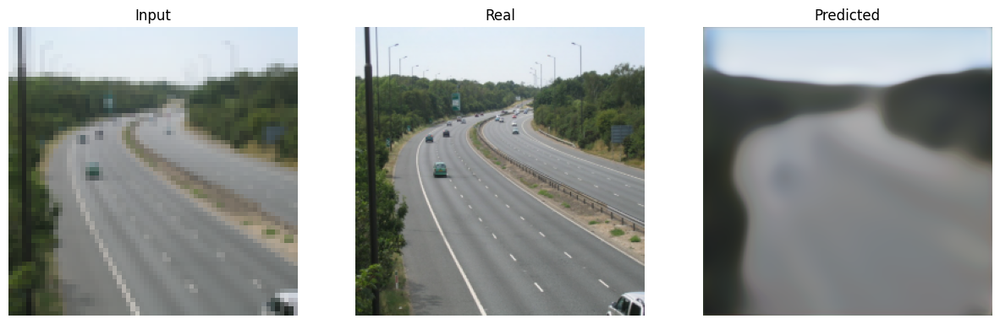

-----------------------------------------------------------
| End of epoch  25 | Time: 29.41s | Train psnr   17.330 | Train Loss    0.191 | Valid psnr   18.061 | Valid Loss    0.166 
-----------------------------------------------------------
| epoch  26 |    50/   86 batches | psnr   16.898
-----------------------------------------------------------
| End of epoch  26 | Time: 28.61s | Train psnr   16.807 | Train Loss    0.200 | Valid psnr   17.385 | Valid Loss    0.192 
-----------------------------------------------------------
| epoch  27 |    50/   86 batches | psnr   16.400
-----------------------------------------------------------
| End of epoch  27 | Time: 28.54s | Train psnr   17.277 | Train Loss    0.203 | Valid psnr   17.123 | Valid Loss    0.195 
-----------------------------------------------------------
| epoch  28 |    50/   86 batches | psnr   17.374
-----------------------------------------------------------
| End of epoch  28 | Time: 28.53s | Train psnr   17.788 | Tra

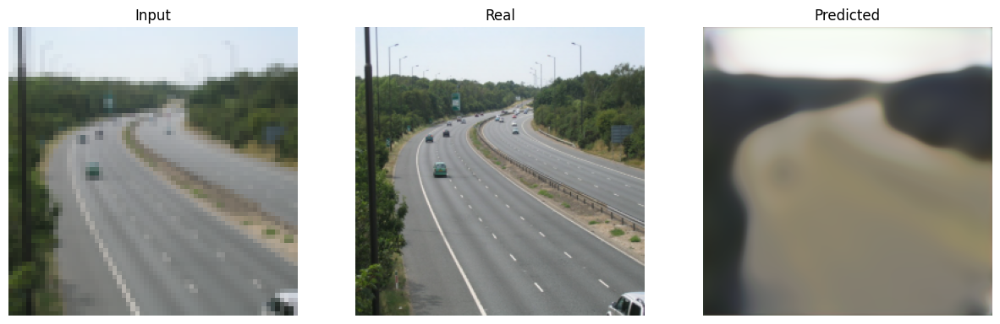

-----------------------------------------------------------
| End of epoch  31 | Time: 29.39s | Train psnr   17.484 | Train Loss    0.190 | Valid psnr   18.098 | Valid Loss    0.169 
-----------------------------------------------------------
| epoch  32 |    50/   86 batches | psnr   17.191
-----------------------------------------------------------
| End of epoch  32 | Time: 28.68s | Train psnr   17.620 | Train Loss    0.185 | Valid psnr   15.517 | Valid Loss    0.224 
-----------------------------------------------------------
| epoch  33 |    50/   86 batches | psnr   17.701
-----------------------------------------------------------
| End of epoch  33 | Time: 28.63s | Train psnr   17.844 | Train Loss    0.177 | Valid psnr   18.018 | Valid Loss    0.176 
-----------------------------------------------------------
| epoch  34 |    50/   86 batches | psnr   17.620
-----------------------------------------------------------
| End of epoch  34 | Time: 28.61s | Train psnr   18.103 | Tra

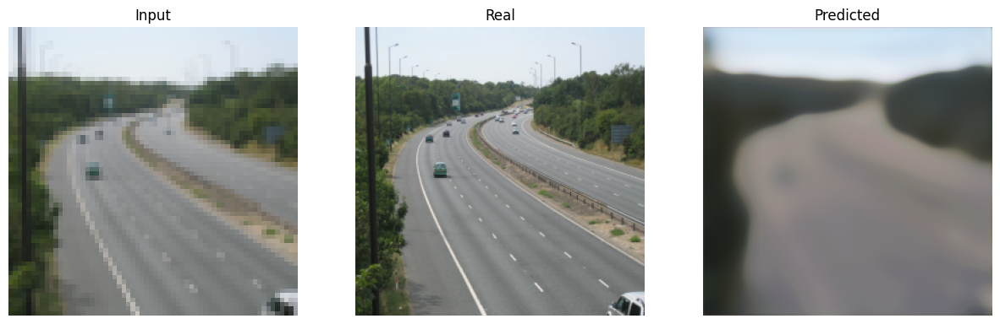

-----------------------------------------------------------
| End of epoch  56 | Time: 29.27s | Train psnr   17.577 | Train Loss    0.194 | Valid psnr   18.169 | Valid Loss    0.169 
-----------------------------------------------------------
| epoch  57 |    50/   86 batches | psnr   18.011
-----------------------------------------------------------
| End of epoch  57 | Time: 28.47s | Train psnr   17.984 | Train Loss    0.172 | Valid psnr   11.680 | Valid Loss    0.339 
-----------------------------------------------------------
| epoch  58 |    50/   86 batches | psnr   17.875
-----------------------------------------------------------
| End of epoch  58 | Time: 28.51s | Train psnr   18.093 | Train Loss    0.172 | Valid psnr   17.780 | Valid Loss    0.182 
-----------------------------------------------------------
| epoch  59 |    50/   86 batches | psnr   17.429
-----------------------------------------------------------
| End of epoch  59 | Time: 28.44s | Train psnr   17.686 | Tra

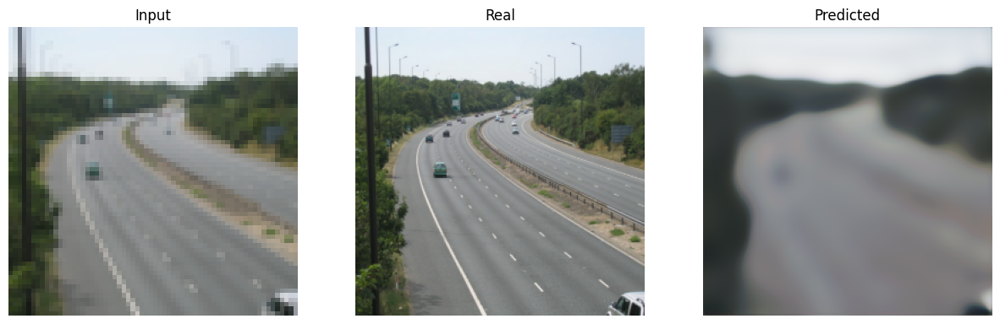

-----------------------------------------------------------
| End of epoch  61 | Time: 29.38s | Train psnr   18.289 | Train Loss    0.170 | Valid psnr   18.330 | Valid Loss    0.157 
-----------------------------------------------------------
| epoch  62 |    50/   86 batches | psnr   16.666
-----------------------------------------------------------
| End of epoch  62 | Time: 28.62s | Train psnr   17.887 | Train Loss    0.192 | Valid psnr   18.316 | Valid Loss    0.166 
-----------------------------------------------------------
| epoch  63 |    50/   86 batches | psnr   18.044
-----------------------------------------------------------
| End of epoch  63 | Time: 28.63s | Train psnr   18.253 | Train Loss    0.168 | Valid psnr   18.324 | Valid Loss    0.168 
-----------------------------------------------------------
| epoch  64 |    50/   86 batches | psnr   18.225
-----------------------------------------------------------
| End of epoch  64 | Time: 28.66s | Train psnr   18.214 | Tra

In [25]:
model_no_skip = UnetNoSkip()
model_no_skip = model_no_skip.to(device)

criterion = nn.L1Loss()
optimizer = optim.Adam(model_no_skip.parameters(), lr=learning_rate, betas=[0.5,0.999])
epochs = 65

save_model = './UNET_No_Skip'
os.makedirs(save_model, exist_ok = True)

model, metrics = train(model_no_skip, 'UNET', save_model, optimizer, criterion, train_loader, test_loader, device, epochs)

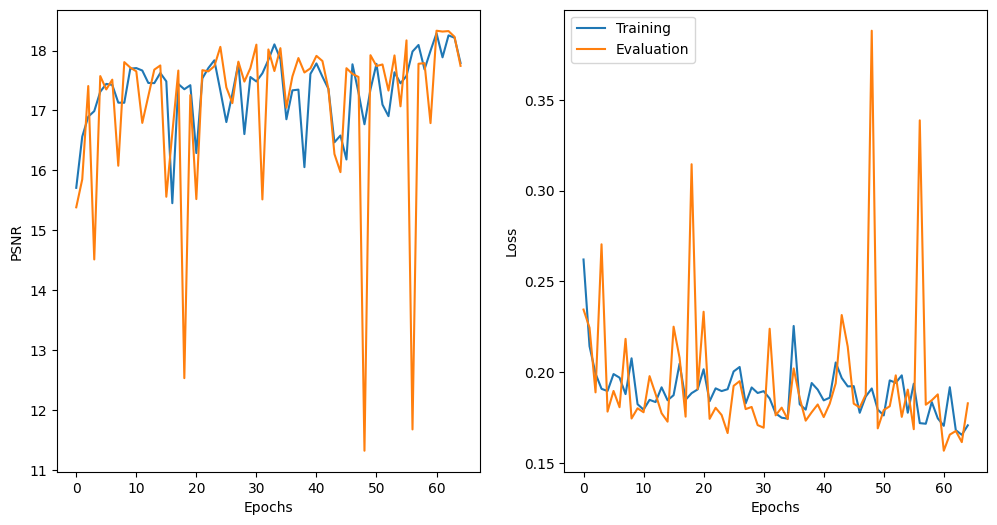

In [26]:
plot_result(
    epochs,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [27]:
test_psnr, test_loss = evaluate(model_no_skip, criterion, test_loader, device)
test_psnr, test_loss

(0.15671447732231833, tensor(18.3304, device='cuda:0'))

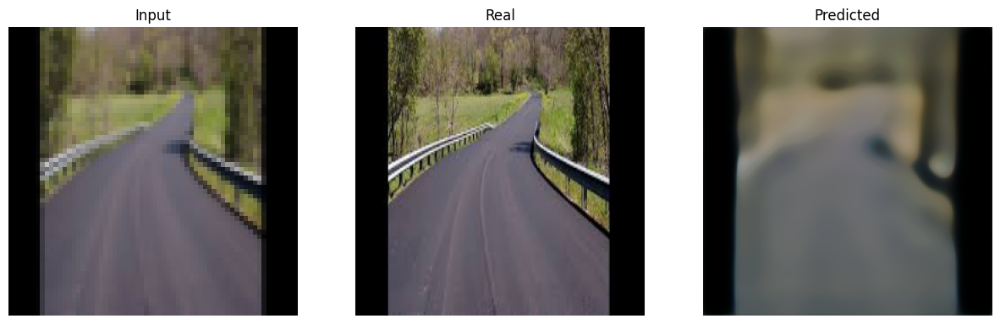

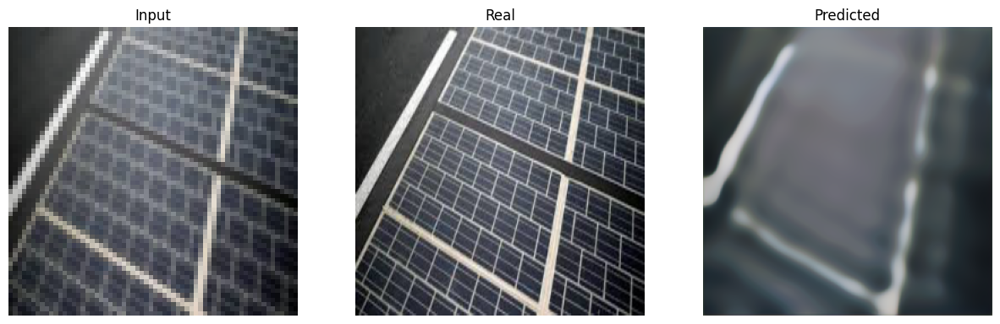

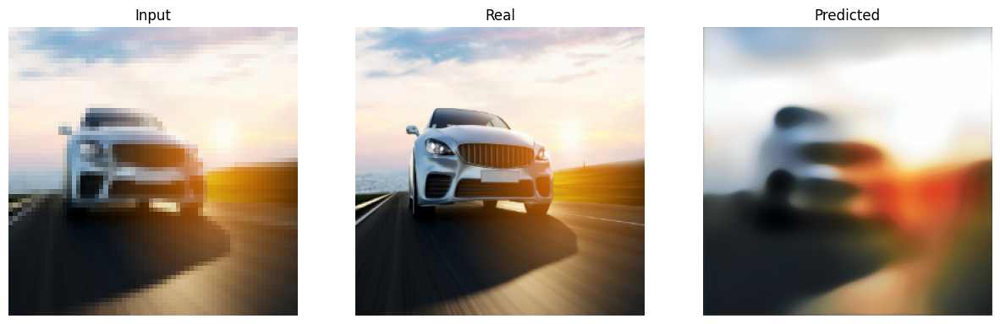

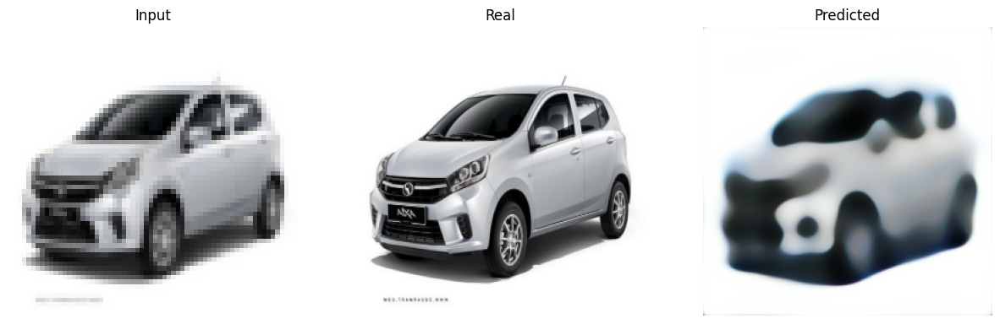

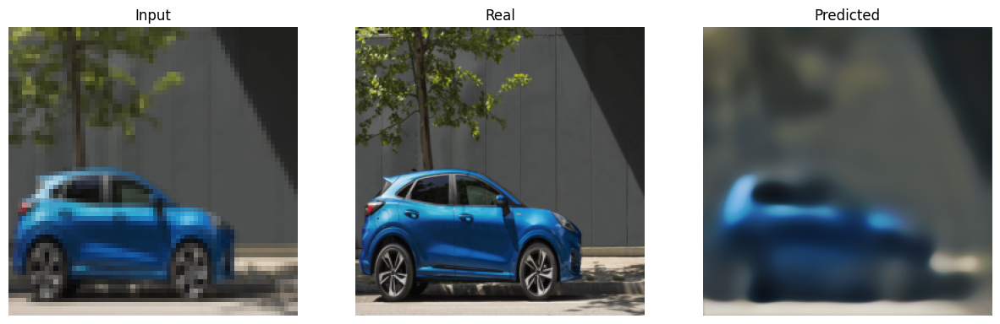

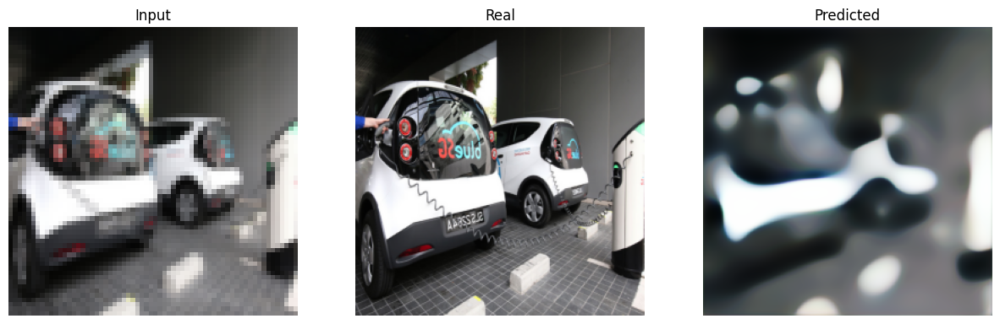

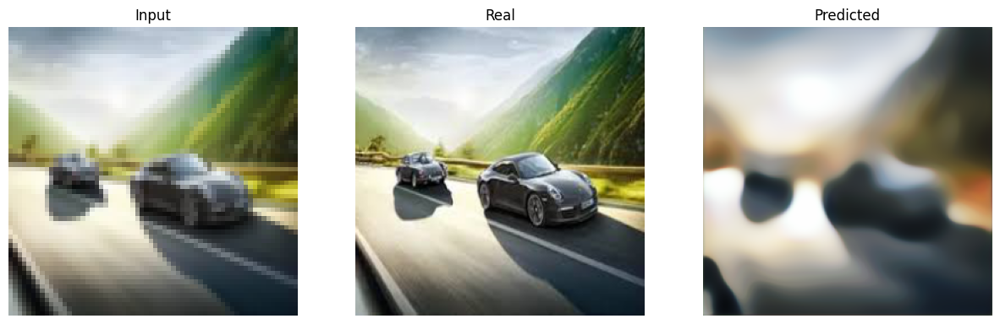

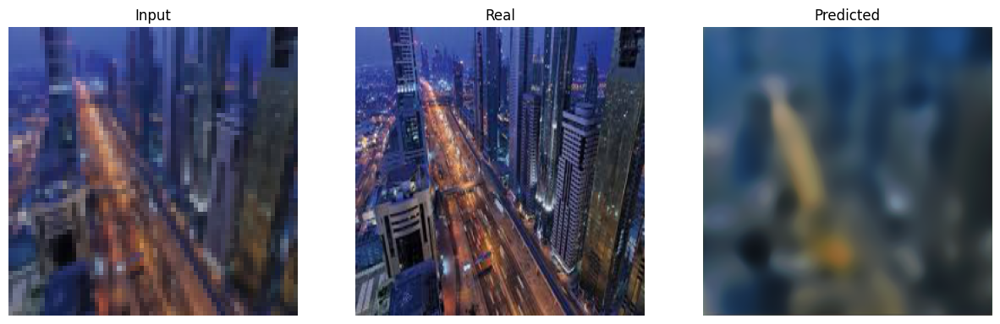

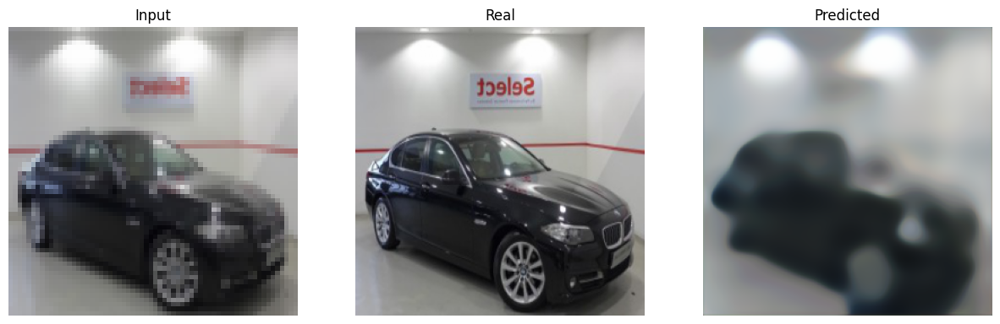

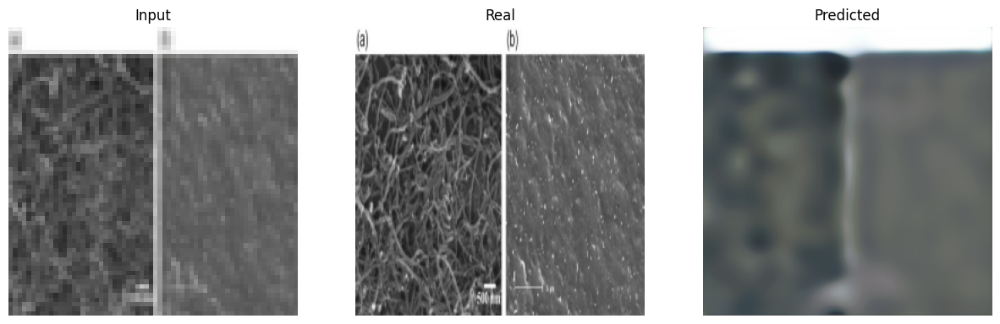

In [28]:
predict_and_display(model_no_skip, train_loader, device)

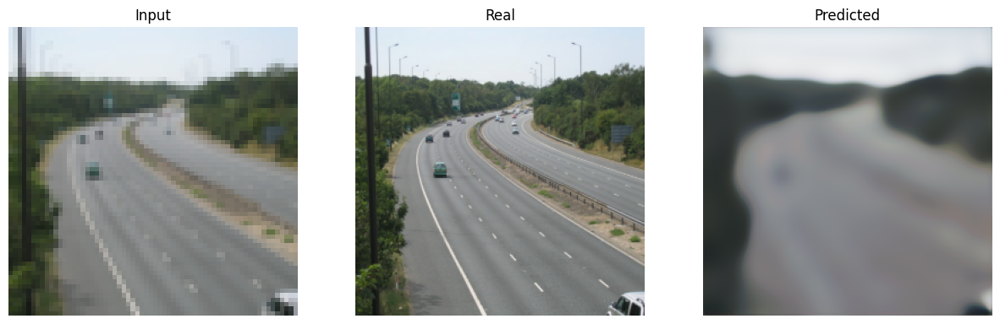

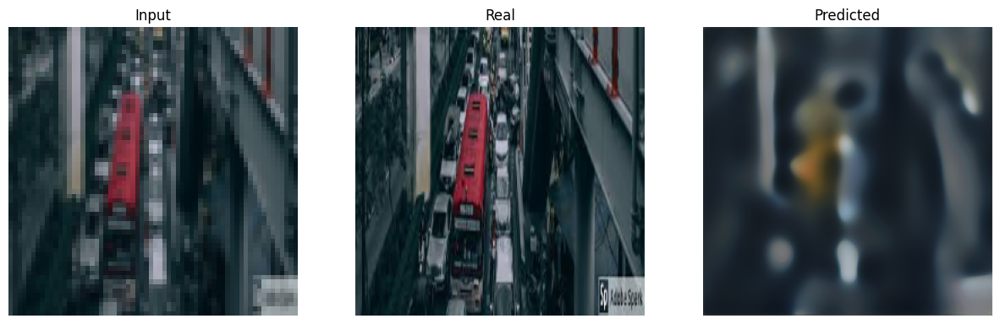

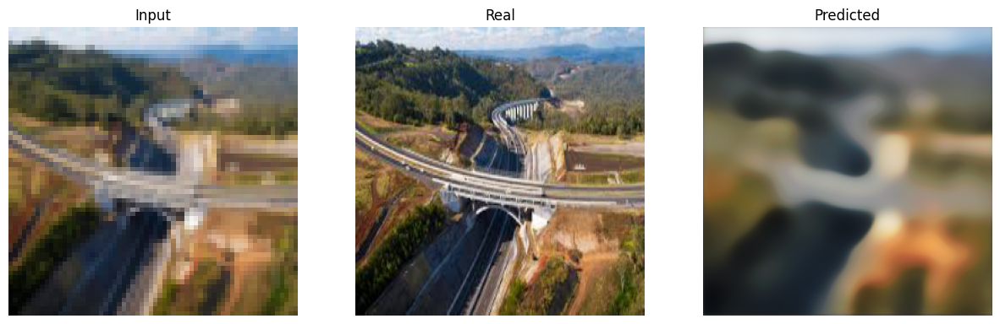

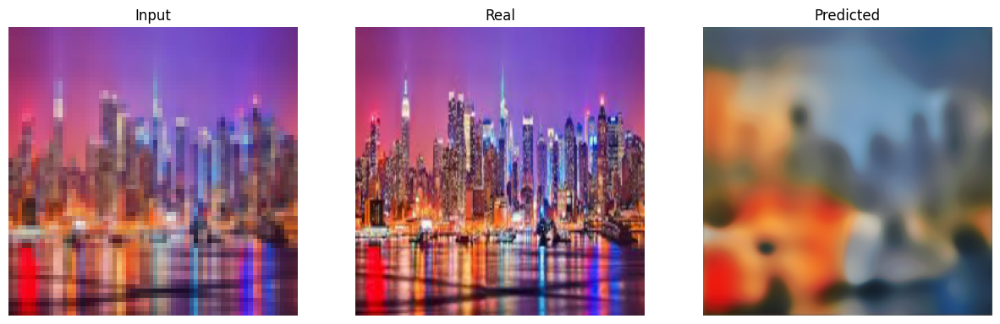

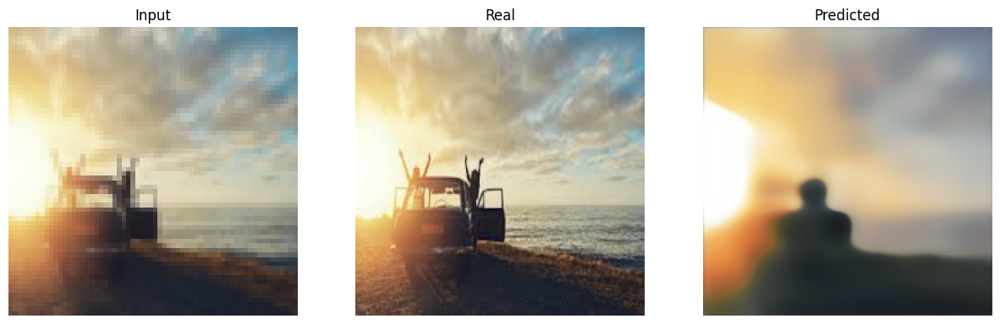

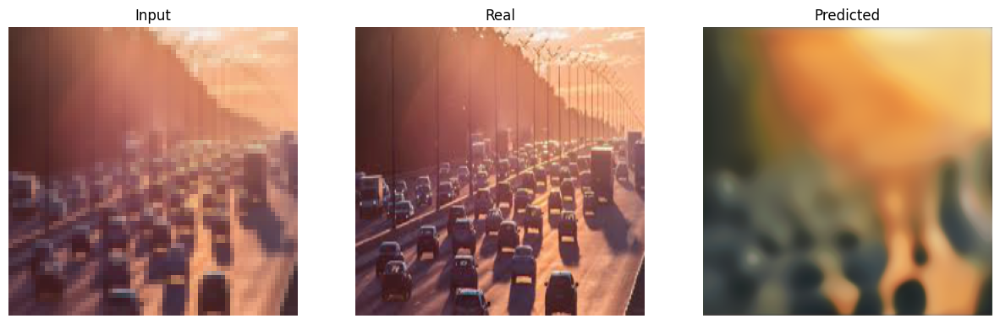

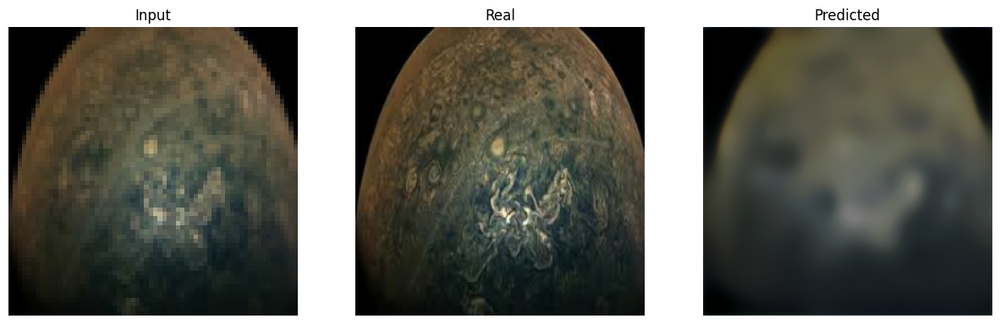

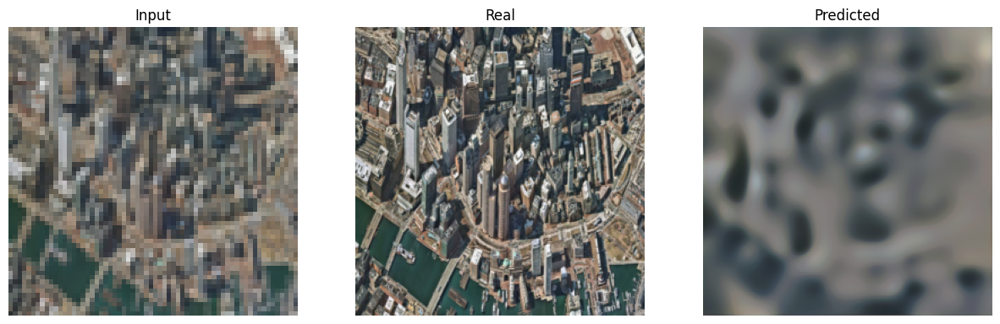

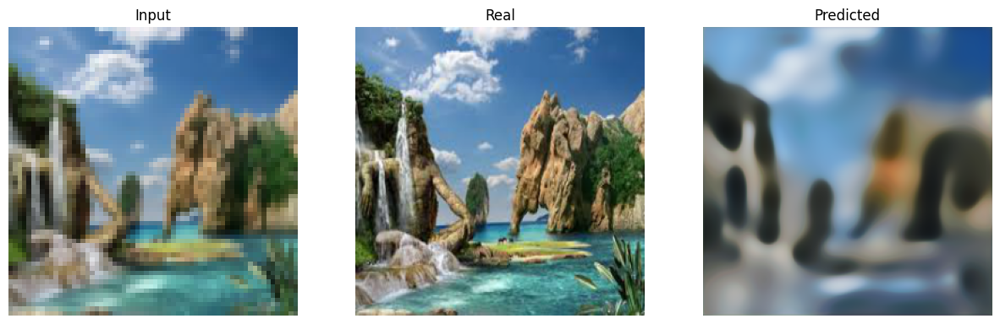

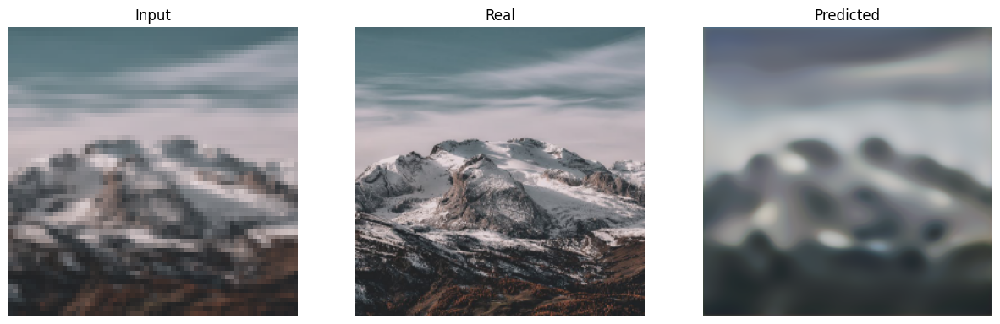

In [29]:
predict_and_display(model_no_skip, test_loader, device)